In [77]:
from keras.preprocessing.image import load_img, img_to_array

target_image_path = "joker.jpg"
style_reference_image_path = "for_style_reference.jpg"

# 原图像的尺寸
width, height = load_img(target_image_path).size
# 指定高度，等比例缩放
img_height = 400
img_width = int(width * img_height / height)

In [78]:
import numpy as np
from keras.applications import vgg19

def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_height, img_width))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img
    
def deprocess_image(x):
    # 逆变换vgg19的一项变换
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779    
    x[:, :, 2] += 123.68
    # BGR-->RGB
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype("uint8")
    return x

In [79]:
from keras import backend as K

target_image = K.constant(preprocess_image(target_image_path))
style_reference_image = K.constant(preprocess_image(style_reference_image_path))
combination_image = K.placeholder((1, img_height, img_width, 3))

input_tensor = K.concatenate([target_image, style_reference_image, combination_image], axis=0)

model = vgg19.VGG19(input_tensor=input_tensor, weights="imagenet", include_top=False)
print("Model loaded.")

Model loaded.


In [80]:
# 用L2Norm评估content的损失
def content_loss(base, combination):
    return K.sum(K.square(combination - base))

In [81]:
# 格拉姆矩阵能从整体上解释图像风格（各点之间的相关性）。比较两张图像的风格差异只需要比较其格拉姆矩阵。
def gram_matrix(x):
    # K.batch_flatten把nDtensor展开为2Dtensor，保留axis=0; K.permute_dimendions交换轴顺序。本句的意思是将输入展开为(channels, n)的二维tensor。
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

In [82]:
def style_loss(style, combination):
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_height * img_width
    return K.sum(K.square(S - C)) / (4. * (channels ** 2) * (size ** 2))

In [83]:
# regulation loss, 使相邻行和列的的元素之差不至于太大，避免生成图像过于马赛克化，不够光滑。
def total_variation_loss(x):
    a = K.square(x[:, :img_height - 1, :img_width - 1, :] - x[:, 1:, :img_width - 1, :])
    b = K.square(x[:, :img_height - 1, : img_width - 1, :] - x[:, :img_height - 1, 1: , :])
    return K.sum(K.pow(a + b, 1.25))

In [84]:
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])
# content_layer只取一个较高的层，代表图像整体的，抽象的的内容。
content_layer = "block5_conv2"
# style_layers则取从低到高不同层级的多个层，代表图像在各个尺度上的特征。
style_layers = ["block1_conv1", 
               "block2_conv1",
               "block3_conv1",
               "block4_conv1",
               "block5_conv1"]
# loss是三个loss方程的加权平均，content_weight越高，保留越多target content。
total_variation_weight = 1e-4
style_weight = 1.
content_weight = 0.025

loss = K.variable(0.)

# content_loss。因为输入是三张图像，layer的输出同样是[3,?]
layer_features = outputs_dict[content_layer]
target_image_features = layer_features[0, :, :,:]
combination_features = layer_features[2, :, :,:]
loss = loss + content_weight * content_loss(target_image_features, combination_features)
style_loss
for layer_name in style_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :,:]
    combination_features = layer_features[2, :, :,:]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(style_layers)) * sl

loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [85]:
grads = K.gradients(loss, combination_image)[0]

fetch_loss_and_grads = K.function([combination_image], [loss, grads])
'''
fmin_l_bfgs_b(func, x0, fprime=None..)给出预测的使func最小的x的位置。
func是需要最小化（优化）的函数，对于fmin_l_bfgs_b来说，它在黑盒中。
x0是初始值。fprime是func的梯度函数，同样是黑盒。
maxfun（可能）是最多调用func的次数。函数获得一系列func，x，和梯度的取值，进行拟合，从而给出估计结果。
因为fmin_l_bfgs_b(func, x0, fprime=None..)只接受向量，需要对数据进行处理。
'''
class Evaluator(object):
    def __init__(self):
        self.loss_value = None
        self.grad_values = None
        
    def loss(self, x):
        assert self.loss_value is None
        x = x.reshape((1, img_height, img_width, 3))
        outs = fetch_loss_and_grads([x])
        loss_value = outs[0]
        grad_values = outs[1].flatten().astype("float64")
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value
    
    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

evaluator = Evaluator()

In [86]:
from scipy.optimize import fmin_l_bfgs_b
from imageio import imwrite
import time

result_prefix = "Style-transfer_generated_images/my_result"
iteration = 20
# combination用target图像的值初始化
x = preprocess_image(target_image_path)
x = x.flatten()
for i in range(iteration):
    print("Start of iteration", i)
    start_time = time.time()
    # 返回值x是预测的func最小值的位置，min_val是此处func的值，info是个字典，包含是否收敛，梯度等信息。
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x, fprime=evaluator.grads, maxfun=20)
    print("Current loss value:", min_val)
    img = x.copy().reshape((img_height, img_width, 3))
    img = deprocess_image(img)
    fname = result_prefix + "_at_iteration_%d.png" % i
    imwrite(fname, img)
    print("Image saved as", fname)
    end_time = time.time()
    print("Iteration %d completed in %ds" % (i, end_time - start_time))

Start of iteration 0
Current loss value: 5375014000.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_0.png
Iteration 0 completed in 21s
Start of iteration 1
Current loss value: 1524556300.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_1.png
Iteration 1 completed in 20s
Start of iteration 2
Current loss value: 932356400.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_2.png
Iteration 2 completed in 20s
Start of iteration 3
Current loss value: 695903400.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_3.png
Iteration 3 completed in 20s
Start of iteration 4
Current loss value: 557527200.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_4.png
Iteration 4 completed in 20s
Start of iteration 5
Current loss value: 479857820.0
Image saved as Style-transfer_generated_images/my_result_at_iteration_5.png
Iteration 5 completed in 20s
Start of iteration 6
Current loss value: 402051100

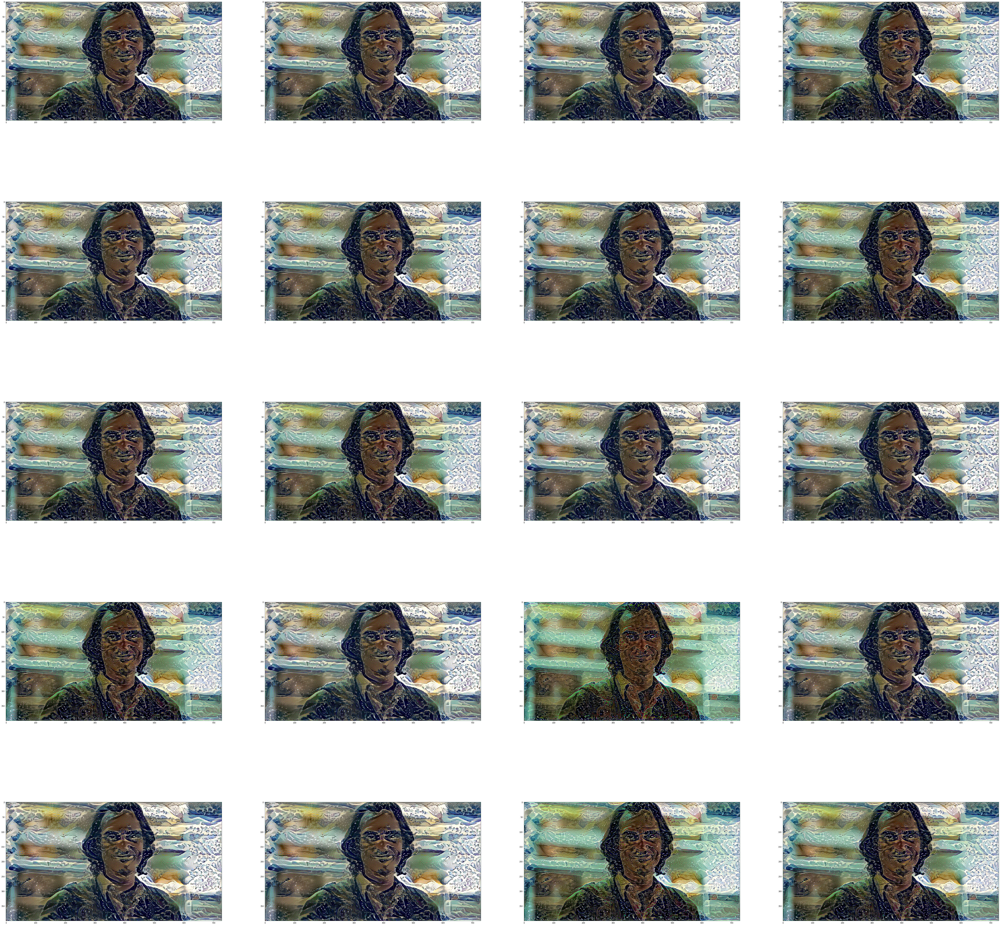

In [87]:
from matplotlib import pyplot as plt
import os

path = "Style-transfer_generated_images"
filenames = os.listdir(path)
file_list = [os.path.join(path, filename) for filename in filenames if os.path.splitext(filename)[1] == ".png"]
fig, axes = plt.subplots(5, 4, figsize=(100, 100))
for (file, axis) in zip(file_list, axes.flatten()):
    img = load_img(file)
    img = img_to_array(img)
    axis.imshow(img.astype("int"))